---
title: Sentinel-1 SLC Zarr Product Exploration
subtitle: Explore how to open, inspect the metadata and process Sentinel-1 SLC Zarr format
authors:
  - name: Michele Claus
    orcid: 0000-0003-3680-381X
    github: clausmichele
    affiliations:
      - id: Eurac Research
        institution: Eurac Research
        ror: 01xt1w755
reviewers:
  - name: Mattia Callegari
    orcid: 0000-0003-1520-1975
    github: mattiacallegari
    affiliations:
      - id: Eurac Research
        institution: Eurac Research
        ror: 01xt1w755
date: 2025-08-28
thumbnail: ../static/ESA_EOPF_logo_2025_COLOR_ESA_blue_reduced.png
keywords: ["sentinel-1", "xarray", "earth observation", "remote sensing"]
tags: ["sentinel-1", "xarray"]
releaseDate: 2025-08-28
datePublished: 2025-08-28
dateModified: 2025-08-28
github: https://github.com/EOPF-Sample-Service/eopf-sample-notebooks
license: Apache-2.0
---

```{image} ../static/ESA_EOPF_logo_2025_COLOR_ESA_blue_reduced.png
:alt: ESA EOPF Zarr Logo
:width: 250px
:align: center
```

# Sentinel-1 SLC Zarr Product Exploration

## Table of Contents
1. [Introduction](#IntroductionSLC)
2. [Import modules](#ImportModulesSLC)
3. [File path definition](#PathSLC)
4. [Open the product](#OpenSLC)
5. [Metadata Inspection](#MetadataSLC)
6. [Overview of the product content](#OverviewSLC)
7. [Examples of product usage](#Examples_SLC)
8. [Amplitude Calculation](#AmplitudeSLC)
9. [Multi-Look](#MultiLookSLC)
9. [Calibration](#CalibrationSLC)
10. [Geocoding using GCPs](#GeocodingSLC)
11. [RGB Plot of two non coregistred burst](#ShiftSLC)

(IntroductionSLC)=
## Introduction
This notebook demonstrates how to open, explore, process and visualize Sentinel-1 Interferometric Wide (IW) SLC products stored in EOPF Zarr format, including accessing, calibrating, geocoding, subsetting and plotting.

:::{hint} Overview

**Questions**
   - How do I access Sentinel-1 SLC in EOPF Zarr format?
   - What is the product structure?
   - How do I get the most important metadata?

**Objectives**
   - Understand the burst based structure and allow easy access to them, since they are the data unit that is typically processed.
   - Being able to calibrate and geocode the data.
   - Being able to compute the amplitude and intensity from the compelx data.
   - Being able to perform a Multi-Look filtering operation.
   - Being able geocode the data
:::

(ImportModulesSLC)=
## Import modules

In [1]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

xr.set_options(display_expand_attrs=False)

(PathSLC)=
## Products Definition

**SLC Product 1**: S1A_IW_SLC__1SDV_20231119T170635_20231119T170702_051289_063021_178F  
**SLC Product 2**: S1A_IW_SLC__1SDV_20231201T170634_20231201T170701_051464_06361B_A27C

Remote files URLs

In [2]:
remote_product_url_1 = "https://objects.eodc.eu:443/e05ab01a9d56408d82ac32d69a5aae2a:notebook-data/tutorial_data/cpm_v260/S1A_IW_SLC__1SDV_20231119T170635_20231119T170702_051289_063021_178F.zarr"
remote_product_url_2 = "https://objects.eodc.eu:443/e05ab01a9d56408d82ac32d69a5aae2a:notebook-data/tutorial_data/cpm_v260/S1A_IW_SLC__1SDV_20231201T170634_20231201T170701_051464_06361B_A27C.zarr"

(OpenSLC)=
## Open the product

The SLC product can be opened as a `DataTree` using Xarray:

In [3]:
dt = xr.open_datatree(remote_product_url_1, engine="zarr", chunks={})
dt

<xarray.DataTree>
Group: /
│   Attributes: (2)
├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411
│   │   Attributes: (2)
│   ├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/conditions
│   │   ├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/conditions/antenna_pattern
│   │   │       Dimensions:              (azimuth_time: 10, count: 712)
│   │   │       Coordinates:
│   │   │         * azimuth_time         (azimuth_time) datetime64[ns] 80B 2023-11-19T17:06:3...
│   │   │         * count                (count) int64 6kB 0 1 2 3 4 5 ... 707 708 709 710 711
│   │   │       Data variables:
│   │   │           elevation_angle      (azimuth_time, count) float32 28kB dask.array<chunksize=(10, 712), meta=np.ndarray>
│   │   │           incidence_angle      (azimuth_time, count) float32 28kB dask.array<chunksize=(10, 712), meta=np.ndarray>
│   │   │           roll                 (azimuth_time) float64 80B dask.array<chunksize=(10,), meta=np.ndarray>
│   │   │           slant_range_time_ap  (azimuth_time, count) float64 57kB dask.array<chunksize=(10, 712), meta=np.ndarray>
│   │   │           swath                (azimuth_time) <U3 120B dask.array<chunksize=(10,), meta=np.ndarray>
│   │   │           terrain_height       (azimuth_time) float64 80B dask.array<chunksize=(10,), meta=np.ndarray>
│   │   ├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/conditions/attitude
│   │   │       Dimensions:       (azimuth_time: 25)
│   │   │       Coordinates:
│   │   │         * azimuth_time  (azimuth_time) datetime64[ns] 200B 2023-11-19T17:06:36.8749...
│   │   │       Data variables:
│   │   │           pitch         (azimuth_time) float64 200B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           q0            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           q1            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           q2            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           q3            (azimuth_time) float32 100B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           roll          (azimuth_time) float64 200B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           wx            (azimuth_time) float64 200B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           wy            (azimuth_time) float64 200B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           wz            (azimuth_time) float64 200B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   │           yaw           (azimuth_time) float64 200B dask.array<chunksize=(25,), meta=np.ndarray>
│   │   ├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/conditions/azimuth_fm_rate
│   │   │       Dimensions:                     (azimuth_time: 10, degree: 3)
│   │   │       Coordinates:
│   │   │         * azimuth_time                (azimuth_time) datetime64[ns] 80B 2023-11-19T...
│   │   │       Dimensions without coordinates: degree
│   │   │       Data variables:
│   │   │           azimuth_fm_rate_polynomial  (azimuth_time, degree) float64 240B dask.array<chunksize=(10, 3), meta=np.ndarray>
│   │   │           t0                          (azimuth_time) float64 80B dask.array<chunksize=(10,), meta=np.ndarray>
│   │   ├── Group: /S01SIWSLC_20231119T170635_0027_A293_178F_063021_VH_IW1_249411/conditions/doppler_centroid
│   │   │       Dimensions:                            (azimuth_time: 10, degree: 3)
│   │   │       Coordinates:
│   │   │         * azimuth_time                       (azimuth_time) datetime64[ns] 80B 2023...
│   │   │         * degree                             (degree) int64 24B 2 1 0
│   │   │       Data variables:
│   │   │           data_dc_polynomial                 (azimuth_time, degree) float32 120B dask.array<chunksize=(10, 3), meta=np.ndarray>
│   │   │       

(MetadataSLC)=
## Metadata Inspection

When you work with Sentinel-1 data, you typically want to know the product location, the orbit direction and number, which are necessary information to consider if you would like to work combination of products. We can find these in the product attributes.

### Explore product geolocation

The Zarr product metadata contains information about the product geolocation we can explore in various ways. For instance, we can show the product footprint on an interactive map.

In [4]:
import geopandas as gpd

# Create a GeoDataFrame from the feature
gdf = gpd.GeoDataFrame.from_features(
    [
        {
            "type": "Feature",
            "geometry": dt.attrs["stac_discovery"][
                "geometry"
            ],  # Use the actual geometry, not the bbox
            "properties": dt.attrs["stac_discovery"][
                "properties"
            ],  # Include all properties
        }
    ],
    crs="EPSG:4326",  # Set the CRS explicitly (adjust EPSG code if needed)
)
gdf.explore()

### Get Orbit Information

In the `properties` field of the STAC metadata, we can find the required orbit values:

In [5]:
dt.attrs["stac_discovery"]["properties"]

{'constellation': 'sentinel-1',
 'created': '2023-11-19T17:54:50.000000Z',
 'datetime': '2023-11-19T17:06:48.793220Z',
 'end_datetime': '2023-11-19T17:07:02.279725Z',
 'eopf:datatake_id': '405537',
 'eopf:instrument_mode': 'IW',
 'instruments': 'sar',
 'platform': 'sentinel-1a',
 'processing:software': {'name': 'Sentinel-1 EOPF', 'version': '2.5.8'},
 'product:timeliness': 'PT3H',
 'product:timeliness_category': 'NRT-3h',
 'product:type': 'S01SIWSLC',
 'provider': [{'name': 'Copernicus Ground Segment', 'roles': ['processor']},
  {'name': 'ESA', 'roles': ['producer']}],
 'sar:frequency_band': 'C',
 'sar:instrument_mode': 'IW',
 'sar:polarizations': ['VV', 'VH'],
 'sat:absolute_orbit': 51289,
 'sat:anx_datetime': '2023-11-19T16:55:04.389887',
 'sat:orbit_state': 'ascending',
 'sat:platform_international_designator': '2014-016A',
 'sat:relative_orbit': 117,
 'start_datetime': '2023-11-19T17:06:35.306715Z'}

In [6]:
orbit_direction = dt.attrs["stac_discovery"]["properties"]["sat:orbit_state"]
orbit_number = dt.attrs["stac_discovery"]["properties"]["sat:relative_orbit"]

print("Orbit Direction: ",orbit_direction,"\nOrbit Number: ",orbit_number)

Orbit Direction:  ascending 
Orbit Number:  117


(OverviewSLC)=
## Overview of the product content

IW SLC products consist of three sub-swaths images per polarization channel, for a
total of three (single polarizations) or six (dual polarization) images in an IW product. Each sub-swath image
consists of a series of bursts, where each burst has been processed as a separate SLC image.

**The bursts are the light blue rectangles in the figure below. A sub-swath (IW1) is highlighted in red.**

If you want to know more, please refer to: https://sentiwiki.copernicus.eu/web/s1-products

```{image} ./S1_bursts.png
:alt: Sentinel-1 bursts in blue and sub-swath IW1 highlighted in red
:width: 600px
:align: center
```
Map data by [OpenStreetMap](https://www.openstreetmap.org/)

The EOPF Zarr SLC product contains one group for each burst.
Each burst is identified by the following elements:
1. **Polarization**: typically VV or VH
2. **Sub-swath**: IW1, IW2 or IW3
3. **Burst Id**

**How many burst does this product contain for each polarization?**

We can count how many `children` of the `DataTree` contain the `VH` polarization. Each children correspond to a burst.

In [7]:
polarization = "VH"
bursts_VH = [x for x in dt.children if polarization in x]
print(f"The product contains {len(bursts_VH)} burst for the polarization {polarization}")

The product contains 27 burst for the polarization VH


(Examples_SLC)=
## Examples of product usage

### SLC data extraction

The SLC (Single Look Complex) data is located in the measurements/slc group.

In [8]:
subswath = "IW1"
polarization = "VH"
burst_id = "249411"

burst_group = [x for x in dt.children if (polarization in x) and (subswath in x) and (burst_id in x)][0]

burst_slc = dt[burst_group].measurements.slc.to_dataset()
burst_slc

<xarray.Dataset> Size: 273MB
Dimensions:           (azimuth_time: 1501, slant_range_time: 22694)
Coordinates:
  * azimuth_time      (azimuth_time) datetime64[ns] 12kB 2023-11-19T17:06:36....
    line              (azimuth_time) int64 12kB dask.array<chunksize=(1501,), meta=np.ndarray>
    pixel             (slant_range_time) int64 182kB dask.array<chunksize=(4096,), meta=np.ndarray>
  * slant_range_time  (slant_range_time) float64 182kB 0.005337 ... 0.005689
Data variables:
    slc               (azimuth_time, slant_range_time) complex64 273MB dask.array<chunksize=(1501, 4096), meta=np.ndarray>

(AmplitudeSLC)=
### Amplitude

The amplitude of the complex signal can be computed as:

$$ Amplitude = \sqrt {i^2 + q^2} $$

We can compute it by extracting real and imaginary parts from the complex data:

In [9]:
burst_amp = (burst_slc.real**2 + burst_slc.imag**2)**0.5

Or also more easily:

In [10]:
burst_amp = abs(burst_slc)

In [11]:
burst_amp

<xarray.Dataset> Size: 137MB
Dimensions:           (azimuth_time: 1501, slant_range_time: 22694)
Coordinates:
  * azimuth_time      (azimuth_time) datetime64[ns] 12kB 2023-11-19T17:06:36....
    line              (azimuth_time) int64 12kB dask.array<chunksize=(1501,), meta=np.ndarray>
    pixel             (slant_range_time) int64 182kB dask.array<chunksize=(4096,), meta=np.ndarray>
  * slant_range_time  (slant_range_time) float64 182kB 0.005337 ... 0.005689
Data variables:
    slc               (azimuth_time, slant_range_time) float32 136MB dask.array<chunksize=(1501, 4096), meta=np.ndarray>

(MultiLookSLC)=
### Multi-Look

Multilook processing is an optional step and can be used to produce a product with nominal image pixel size.  
Multiple looks may be generated by averaging over range and/or azimuth resolution cells improving radiometric resolution but degrading spatial resolution. As a result, the image will have less noise and approximate square pixel spacing after being converted from slant range to ground range.

For more info please visit: https://step.esa.int/docs/tutorials/S1TBX%20SAR%20Basics%20Tutorial.pdf 

To perform multi-looking with Xarray, we use the `coarsen` method, together with `.mean()` to get the average over the window.

In [12]:
burst_amp_ml = burst_amp.coarsen({"azimuth_time": 1, "slant_range_time":4},boundary="pad").mean()
burst_amp_ml

<xarray.Dataset> Size: 34MB
Dimensions:           (azimuth_time: 1501, slant_range_time: 5674)
Coordinates:
  * azimuth_time      (azimuth_time) datetime64[ns] 12kB 2023-11-19T17:06:36....
    line              (azimuth_time) float64 12kB dask.array<chunksize=(1501,), meta=np.ndarray>
    pixel             (slant_range_time) float64 45kB dask.array<chunksize=(1024,), meta=np.ndarray>
  * slant_range_time  (slant_range_time) float64 45kB 0.005337 ... 0.005689
Data variables:
    slc               (azimuth_time, slant_range_time) float32 34MB dask.array<chunksize=(1501, 1024), meta=np.ndarray>

(CalibrationSLC)=
### Calibration

We firstly need to extract the Calibration LUT (Lookup Table) values, located in the quality/calibration group.

In [13]:
calibration_lut = dt[burst_group].quality.calibration.to_dataset()
calibration_lut

<xarray.Dataset> Size: 271kB
Dimensions:           (azimuth_time: 29, slant_range_time: 569)
Coordinates:
  * azimuth_time      (azimuth_time) datetime64[ns] 232B 2023-11-19T17:06:35....
    line              (azimuth_time) uint32 116B dask.array<chunksize=(29,), meta=np.ndarray>
    pixel             (slant_range_time) uint32 2kB dask.array<chunksize=(569,), meta=np.ndarray>
  * slant_range_time  (slant_range_time) float64 5kB 0.0 1.259e+06 ... 7.141e+08
Data variables:
    beta_nought       (azimuth_time, slant_range_time) float32 66kB dask.array<chunksize=(29, 569), meta=np.ndarray>
    dn                (azimuth_time, slant_range_time) float32 66kB dask.array<chunksize=(29, 569), meta=np.ndarray>
    gamma             (azimuth_time, slant_range_time) float32 66kB dask.array<chunksize=(29, 569), meta=np.ndarray>
    sigma_nought      (azimuth_time, slant_range_time) float32 66kB dask.array<chunksize=(29, 569), meta=np.ndarray>

#### Calibrate Data

You can get more information about this step at page 7 [of this official ESA document.](https://sentiwiki.copernicus.eu/__attachments/1673968/ESA-EOPG-CSCOP-TN-0002%20-%20Sentienl-1%20Radiometric%20Calibration%20of%20Products%202015%20-%201.0.pdf?inst-v=a5aa7802-c4f6-43c2-a2e2-32e479f779e6)

In [14]:
calibration_matrix = calibration_lut.interp_like(burst_amp_ml)
calibrated_measurement = burst_amp_ml / calibration_matrix["sigma_nought"]

#### Plot small subset

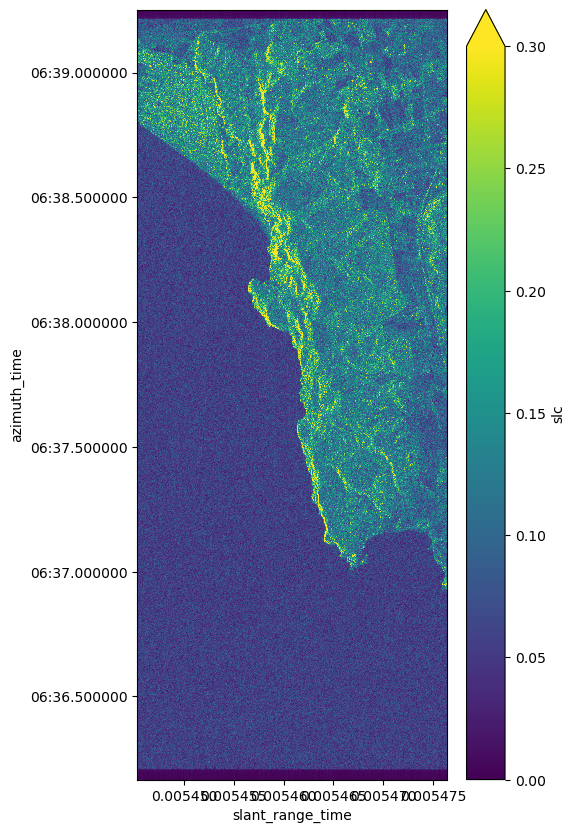

In [15]:
plt.rcParams["figure.figsize"] = (5, 10)
# calibrated_measurement.slc[:, 1750:2250].plot(vmax=0.3)
calibrated_measurement.slc[:, 1750:2250].plot(vmax=0.3)
plt.show()

(GeocodingSLC)=
### Geocoding using Ground Control Points (GCPs)

GCPs serve as anchor points that allow for precise alignment of satellite imagery with actual geographic locations.


#### Open GCP Data

In [16]:
gcp = dt[burst_group].conditions.gcp.to_dataset()
gcp

<xarray.Dataset> Size: 12kB
Dimensions:               (azimuth_time: 10, slant_range_time: 21)
Coordinates:
  * azimuth_time          (azimuth_time) datetime64[ns] 80B 2023-11-19T17:06:...
    line                  (azimuth_time) uint32 40B dask.array<chunksize=(10,), meta=np.ndarray>
    pixel                 (slant_range_time) uint32 84B dask.array<chunksize=(21,), meta=np.ndarray>
  * slant_range_time      (slant_range_time) float64 168B 0.005337 ... 0.005689
Data variables:
    azimuth_time_gcp      (azimuth_time, slant_range_time) datetime64[ns] 2kB dask.array<chunksize=(10, 21), meta=np.ndarray>
    elevation_angle       (azimuth_time, slant_range_time) float64 2kB dask.array<chunksize=(10, 21), meta=np.ndarray>
    height                (azimuth_time, slant_range_time) float64 2kB dask.array<chunksize=(10, 21), meta=np.ndarray>
    incidence_angle       (azimuth_time, slant_range_time) float64 2kB dask.array<chunksize=(10, 21), meta=np.ndarray>
    latitude              (azimuth_time, slant_range_time) float64 2kB dask.array<chunksize=(10, 21), meta=np.ndarray>
    longitude             (azimuth_time, slant_range_time) float64 2kB dask.array<chunksize=(10, 21), meta=np.ndarray>
    slant_range_time_gcp  (azimuth_time, slant_range_time) float64 2kB dask.array<chunksize=(10, 21), meta=np.ndarray>

#### Interpolate and assign new geographic coordinates

In [17]:
gcp_iterpolated = gcp.interp_like(calibrated_measurement)
calibrated_measurement = calibrated_measurement.assign_coords(
    {"latitude": gcp_iterpolated.latitude, "longitude": gcp_iterpolated.longitude}
)

#### Plot geocoded subset

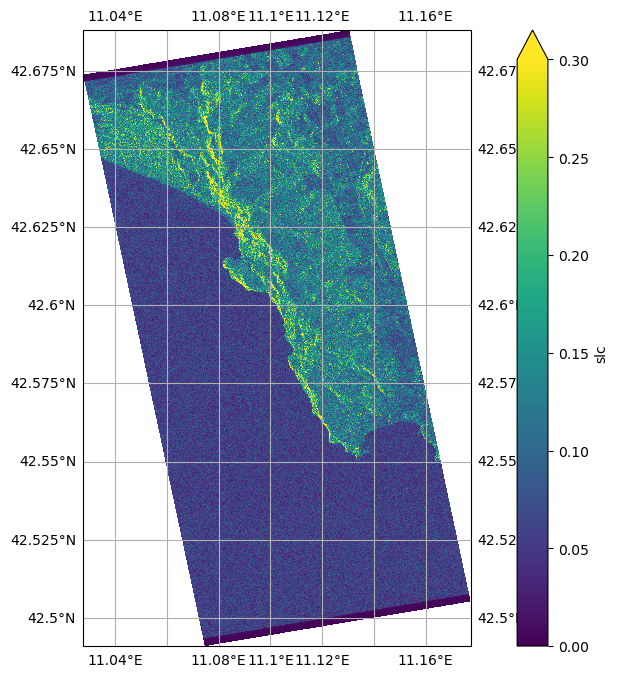

In [18]:
import cartopy.crs as ccrs

_, ax = plt.subplots(subplot_kw={"projection": ccrs.Miller()}, figsize=(12, 8))
gl = ax.gridlines(
    draw_labels=True, crs=ccrs.PlateCarree(), x_inline=False, y_inline=False
)
abs(calibrated_measurement.slc[:, 1750:2250]).plot(
    ax=ax, transform=ccrs.PlateCarree(), x="longitude", y="latitude", vmax=0.3
)
plt.show()

(ShiftSLC)=
### RGB Plot of two non coregistred burst

The RBG plot shows the shift between the non co-registred bursts

- subswath: IW1
- polarization: VH
- burst_id: 249411
- burst acquisition date:
    - 2023-12-01
    - 2023-11-19

#### Open Data

In [19]:
dt2 = xr.open_datatree(remote_product_url_2, engine="zarr")
burst_group2 = [x for x in dt2.children if (polarization in x) and (subswath in x) and (burst_id in x)][0]

burst_slc2 = dt2[burst_group2].measurements.slc.to_dataset()

burst_amp = burst_amp.drop_vars(["azimuth_time", "slant_range_time"])
burst_amp2 = abs(burst_slc2).drop_vars(["azimuth_time", "slant_range_time"])

#### Compose RGB

In [20]:
rgb = xr.concat([burst_amp, burst_amp, burst_amp2], dim="rgb")
rgb = xr.where(rgb > 200, 200, rgb) / 200

#### Plot Subset

The following visualization will highlight the differences of the data acquired in the two different dates, which depend on the slight differences in the satellite orbit.  
To combine Sentinel-1 data samples from different dates as a time series, it's necessary to co-register the images first for the best result, or work with the geocoded data.

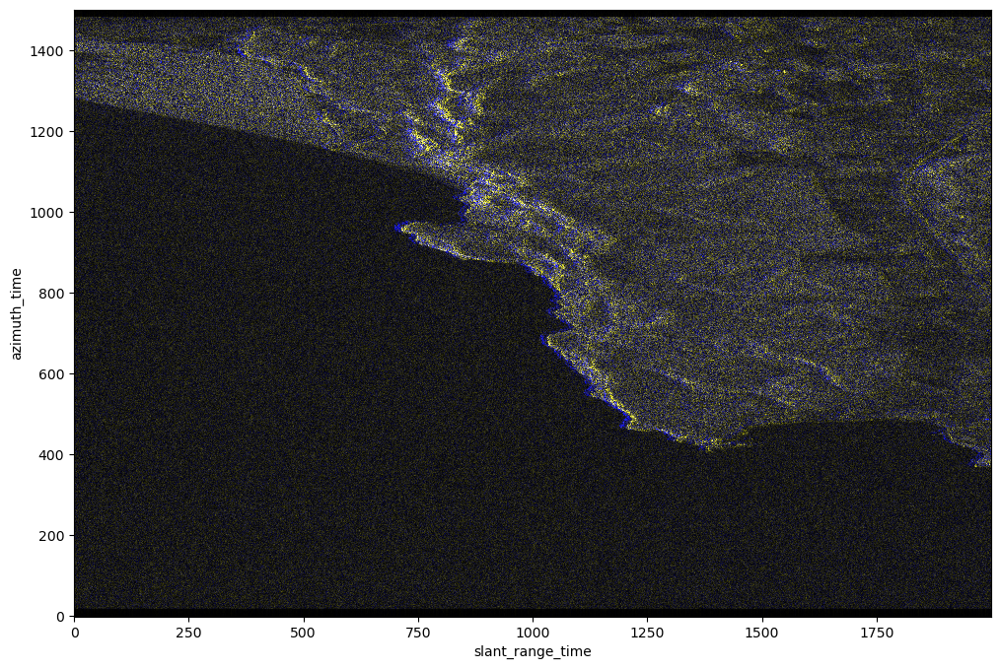

In [21]:
plt.figure(figsize=(12, 8))
rgb.slc[:, :, 7000:9000].plot.imshow(rgb="rgb")
plt.show()

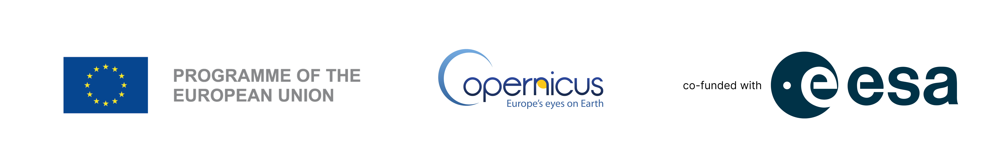